1. id		--		ID exclusivo para o cliente

2. Gender		--		sexo do cliente

3. Age		--		idade do cliente

4. Driving_License	 	--	1 : Cliente já possui Seguro Automóvel, 0 : Cliente não possui Seguro Automóvel

5. Region_Code		--	Código único para a região do cliente

6. Previously_Insured		-- 1 : Cliente já possui Seguro Automóvel, 0 : Cliente não possui Seguro Automóvel

7. Vehicle_Age		--	Idade do Veiculo

8. Vehicle_Damage		--	1 : O cliente teve seu veículo danificado no passado. 0 : O cliente não teve seu veículo danificado no passado.

9. Annual_Premium		--	O valor que o cliente precisa pagar como prêmio no ano

10. Policy_Sales_Channel	--	Código anônimo para o canal de divulgação para o cliente, ou seja. Agentes diferentes, por correio, por telefone, pessoalmente, etc.

11. Vintage		--		Número de dias em que o cliente está associado à empresa

12. Response	--		1: O cliente está interessado, 0: O cliente não está interessado

## Imports

### Libs

In [7]:
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
import scikitplot as skplt
import plotly.express as px
import matplotlib.pyplot as plt

from sklearn import preprocessing as pp
from sklearn import model_selection as ms
from sklearn import ensemble as en
from sklearn import neighbors as nh
from sklearn import linear_model as lm

from sklearn.metrics import roc_auc_score

#ignorando warnings
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

C:\Users\Cliente\AppData\Local\Temp\ipykernel_9024\1656899201.py:20: MatplotlibDeprecationWarning: mplDeprecation was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use matplotlib.MatplotlibDeprecationWarning instead.
  warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)


### Data Descriptive

 - full data 381k
 - training data 305k
 - validation data 76k

In [8]:
df = pd.read_csv('train.csv')

In [9]:
#treino
training = df.copy()

In [10]:
training.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


### Data dimension

In [11]:
training.shape

(381109, 12)

### Check NA

In [12]:
training.isnull().sum()

id                      0
Gender                  0
Age                     0
Driving_License         0
Region_Code             0
Previously_Insured      0
Vehicle_Age             0
Vehicle_Damage          0
Annual_Premium          0
Policy_Sales_Channel    0
Vintage                 0
Response                0
dtype: int64

### data types

In [13]:
training.dtypes

id                        int64
Gender                   object
Age                       int64
Driving_License           int64
Region_Code             float64
Previously_Insured        int64
Vehicle_Age              object
Vehicle_Damage           object
Annual_Premium          float64
Policy_Sales_Channel    float64
Vintage                   int64
Response                  int64
dtype: object

## Data Cleaning

In [14]:
training.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0


In [15]:
#transformando nomes da coluna em minusculo
training.columns = training.columns.str.lower()

training.columns

Index(['id', 'gender', 'age', 'driving_license', 'region_code',
       'previously_insured', 'vehicle_age', 'vehicle_damage', 'annual_premium',
       'policy_sales_channel', 'vintage', 'response'],
      dtype='object')

In [16]:
#transformando de float para int
training['region_code'] = training['region_code'].astype(int)

training['annual_premium'] = training['annual_premium'].astype(int)

training['policy_sales_channel'] = training['policy_sales_channel'].astype(int)

#transformando idade de veiculo em int
training['vehicle_age'] = training['vehicle_age'].apply(lambda x: 'over_2_years' if x == '> 2 Years' else 'between_1_2_years' if x == '1-2 Year' else 'below_1_years')

#Vehicle_Damage em binario
training['vehicle_damage'] = training['vehicle_damage'].apply(lambda x: 1 if x == 'Yes' else 0)

## Data Description

In [17]:
training.describe().T

,count,mean,std,min,25%,50%,75%,max
id,381109.0,190555.000000,110016.836208,1.0,95278.0,190555.0,285832.0,381109.0
age,381109.0,38.822584,15.511611,20.0,25.0,36.0,49.0,85.0
driving_license,381109.0,0.997869,0.046110,0.0,1.0,1.0,1.0,1.0
region_code,381109.0,26.388807,13.229888,0.0,15.0,28.0,35.0,52.0
previously_insured,381109.0,0.458210,0.498251,0.0,0.0,0.0,1.0,1.0
vehicle_damage,381109.0,0.504877,0.499977,0.0,0.0,1.0,1.0,1.0
annual_premium,381109.0,30564.389581,17213.155057,2630.0,24405.0,31669.0,39400.0,540165.0
policy_sales_channel,381109.0,112.034295,54.203995,1.0,29.0,133.0,152.0,163.0
vintage,381109.0,154.347397,83.671304,10.0,82.0,154.0,227.0,299.0
response,381109.0,0.122563,0.327936,0.0,0.0,0.0,0.0,1.0


## EDA

### Analise Univariada

#### age

In [18]:
px.box(training,x = 'response', y = 'age')

<Axes: title={'center': 'Interessados'}, xlabel='age', ylabel='Count'>

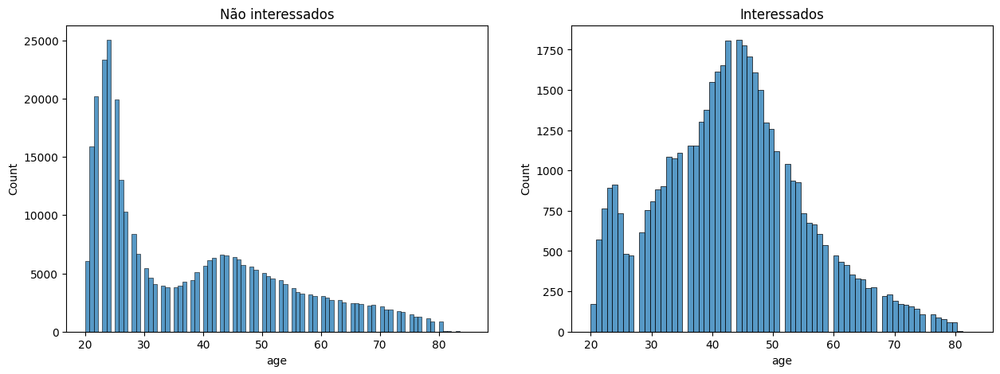

In [19]:
plt.subplots(figsize=(15, 5)) 
plt.subplot(1, 2, 1)
plt.title('Não interessados')
aux = training.loc[training['response'] == 0, 'age']
sns.histplot(aux)

plt.subplot(1, 2, 2)
plt.title('Interessados')
aux = training.loc[training['response'] == 1, 'age']
sns.histplot(aux)

#### annual premium

In [20]:
aux = training[training['annual_premium'] < 80000]
px.box(aux, x = 'response', y = 'annual_premium')

<Axes: title={'center': 'Interessados'}, xlabel='annual_premium', ylabel='Count'>

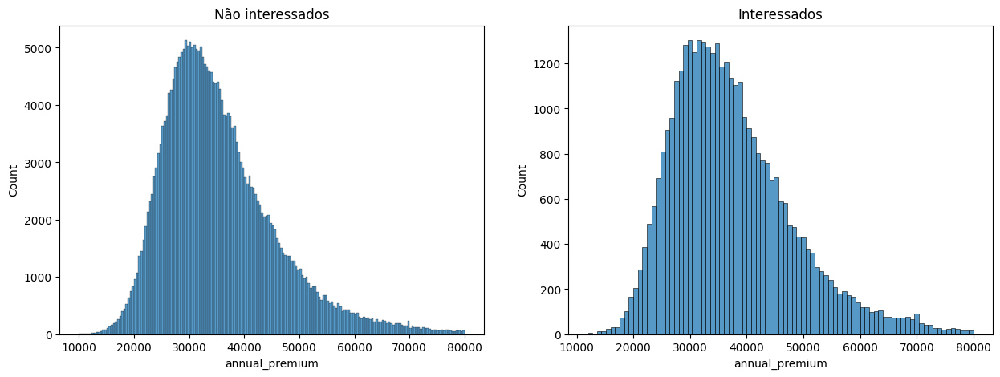

In [21]:
#filtro - exite uma grande presença de outliers
#maior que o min e menor que 80000
aux = training[(training['annual_premium'] > 10000) & (training['annual_premium'] < 80000)]

#graficos
plt.subplots(figsize=(15, 5)) 
plt.subplot(1, 2, 1)
plt.title('Não interessados')
aux0 = aux.loc[training['response'] == 0, 'annual_premium']
sns.histplot(aux0)

plt.subplot(1, 2, 2)
plt.title('Interessados')
aux0 = aux.loc[training['response'] == 1, 'annual_premium']
sns.histplot(aux0)

#### driving license

In [22]:
aux = training[['driving_license', 'response']].groupby('response').sum().reset_index()
#porcentagem de licensas
aux['driving_license_perse'] = aux['driving_license'] / aux['driving_license'].sum()  * 100
aux

,response,driving_license,driving_license_perse
0,0,333628,87.728276
1,1,46669,12.271724


#### region code

In [23]:
#filtro
aux = training[['id','region_code', 'response']].groupby(['region_code', 'response']).count().reset_index()
#grafico
px.scatter(aux, x = 'region_code', y = 'id', color='response')

In [24]:
training.head()

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,response
0,1,Male,44,1,28,0,over_2_years,1,40454,26,217,1
1,2,Male,76,1,3,0,between_1_2_years,0,33536,26,183,0
2,3,Male,47,1,28,0,over_2_years,1,38294,26,27,1
3,4,Male,21,1,11,1,below_1_years,0,28619,152,203,0
4,5,Female,29,1,41,1,below_1_years,0,27496,152,39,0


In [25]:
aux = training.loc[training['region_code'] == 28, ['region_code', 'vehicle_age']]

aux['vehicle_age'].value_counts(normalize=True)

vehicle_age
between_1_2_years    0.737462
below_1_years        0.173021
over_2_years         0.089517
Name: proportion, dtype: float64

#### gender

#### previously insured

In [26]:
pd.crosstab(training['previously_insured'], training['response']).apply(lambda x: x / x.sum(), axis=1)

#response - interesse
#previously_insured - teve seguro

response,0,1
previously_insured,,
0,0.774546,0.225454
1,0.999095,0.000905


#### vehicle age

In [27]:
training[['vehicle_age', 'response']].value_counts(normalize=True).reset_index()

,vehicle_age,response,proportion
0,between_1_2_years,0,0.434285
1,below_1_years,0,0.413488
2,between_1_2_years,1,0.091328
3,over_2_years,0,0.029663
4,below_1_years,1,0.018897
5,over_2_years,1,0.012338


#### vehicle damage

In [28]:
pd.crosstab(training['vehicle_damage'], training['response']).apply(lambda x: x / x.sum(), axis=1)

#vehicle_damage - dano no veiculo
#response - interesse em seguro veicular

response,0,1
vehicle_damage,,
0,0.994796,0.005204
1,0.762345,0.237655


#### policy sales channel

<Axes: xlabel='response', ylabel='policy_sales_channel'>

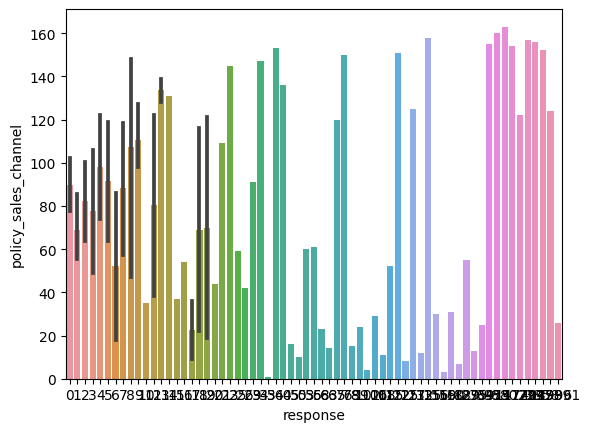

In [29]:
aux = training[['policy_sales_channel', 'response']].groupby('policy_sales_channel').sum().reset_index()
sns.barplot(data=aux, x='response', y='policy_sales_channel')

#### vintage

In [30]:
px.box(training,x = 'response', y = 'vintage')

<Axes: title={'center': 'Interessados'}, xlabel='vintage', ylabel='Count'>

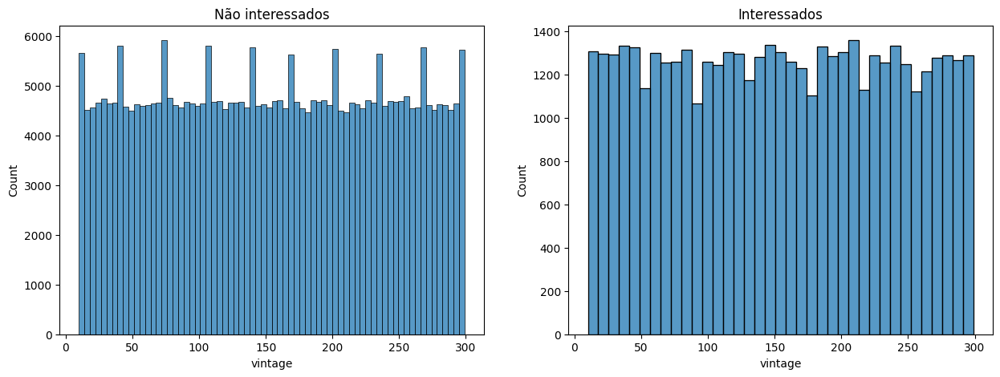

In [31]:
plt.subplots(figsize=(15, 5)) 
plt.subplot(1, 2, 1)
plt.title('Não interessados')
aux = training.loc[training['response'] == 0, 'vintage']
sns.histplot(aux)

plt.subplot(1, 2, 2)
plt.title('Interessados')
aux = training.loc[training['response'] == 1, 'vintage']
sns.histplot(aux)

### Porcentagem da base interessada no produto

In [32]:
interessados = len(training[training['response'] == 1])
nao_interessados = len(training[training['response'] == 0])
porcentagem = np.round((interessados / nao_interessados) * 100)
total = interessados + nao_interessados

print('No dataset com {0} clientes, existem {1} % interessados no seguro automotivo'.format(total, porcentagem))

No dataset com 381109 clientes, existem 14.0 % interessados no seguro automotivo


## Data Split

In [33]:
#setando eixo x e y
x = training.drop('response', axis=1)
y = training['response'].copy()

#separando treino e validação x e y com 20% da base de dados
x_train, x_validation, y_train, y_validation = ms.train_test_split(x, y, test_size=0.20)

#unificanco apenas 
data_concat = pd.concat([x_train, y_train], axis = 1)

## Data Preparation

In [34]:
data = data_concat.copy()

In [35]:
data.columns

Index(['id', 'gender', 'age', 'driving_license', 'region_code',
       'previously_insured', 'vehicle_age', 'vehicle_damage', 'annual_premium',
       'policy_sales_channel', 'vintage', 'response'],
      dtype='object')

### Standardization
 - subtrai a media e divide pelo desvio padrao

In [36]:
ss = pp.StandardScaler()

#annual_premium
data['annual_premium'] = ss.fit_transform(data[['annual_premium']].values)
#pickle.dump(ss, open('src/features/annual_premium_scaler.pkl', 'wb'))

In [37]:
data['annual_premium'].head()

270726   -0.221206
236826    0.037289
193412    0.457881
106671    0.348249
317573   -0.113316
Name: annual_premium, dtype: float64

### Rescaling
 - reescala do intervalos para 0 - 1

In [38]:
#mesmo encoder guardado em var != pois será reutilizado no encoder do dado teste
mms_age = pp.MinMaxScaler()
mms_vintage = pp.MinMaxScaler()

#age
data['age'] = mms_age.fit_transform(data[['age']].values)
#pickle.dump(mms_age, open('src/features/age_scaler.pkl', 'wb'))

#vintage
data['vintage'] = mms_vintage.fit_transform(data[['vintage']].values)
#pickle.dump(mms_vintage, open('src/features/vintage_scaler.pkl', 'wb'))

### Encoder
 - muda de cat para num

In [39]:
#gender - Frequency Encoding
#ao utilizar a var resposta para encodar uma feature, assumimos que os dados presentes nela, se matem no de teste (um risco corrido)
target_encode_gender = data.groupby('gender')['response'].mean()
data.loc[:, 'gender'] = data['gender'].map(target_encode_gender)
#pickle.dump(target_encode_gender, open('src/features/target_encode_gender_scaler.pkl', 'wb'))

#region_encoder - Target Encoding
target_encode_region_code = data.groupby('region_code')['response'].mean()
data.loc[:, 'region_code'] = data['region_code'].map(target_encode_region_code)
#pickle.dump(target_encode_region_code, open('src/features/target_encode_region_code_scaler.pkl', 'wb'))

#vehicle_age - One Hot Encoding
data = pd.get_dummies(data, prefix='vehicle_age', columns=['vehicle_age'])

#policy_sales_channel - Frequency Encoding
frequency_policy_sales_channel = data.groupby('policy_sales_channel').size() / len(data)
data.loc[:, 'policy_sales_channel'] = data['policy_sales_channel'].map(frequency_policy_sales_channel)
#pickle.dump(frequency_policy_sales_channel, open('src/features/fe_policy_sales_channel_scaler.pkl', 'wb'))


### Validation Preparation

In [40]:
#gender
x_validation.loc[:, 'gender'] = x_validation.loc[:, 'gender'].map(target_encode_gender)

#age 
x_validation.loc[:, 'age'] = mms_age.transform(x_validation[['age']].values)

#region_code 
x_validation.loc[:, 'region_code'] = x_validation.loc[:, 'region_code'].map(target_encode_region_code)

#vehicle_age
x_validation = pd.get_dummies(x_validation, prefix='vehicle_age', columns=['vehicle_age'])

#annual_premium
x_validation.loc[:, 'annual_premium'] = ss.transform(x_validation[['annual_premium']].values)

#policy_sales_channel
x_validation.loc[:, 'policy_sales_channel'] = x_validation['policy_sales_channel'].map(frequency_policy_sales_channel)

#vintage
x_validation['vintage'] = mms_vintage.fit_transform(x_validation[['vintage']].values)

#SEMPRE VERIFICAR SE APOS TODA A TRANSFORMAÇÃO ALGUMM DADO FICOU NULO
#fillna - tem regioes no teste que não tem no treino (INVESTIGAR)
x_validation = x_validation.fillna(0)

## Feature Selection

### Feature importance

In [41]:
#model definition
forest = en.ExtraTreesClassifier(n_estimators = 250, random_state = 0, n_jobs = -1)

#data preparation
x_train_n = data.drop(['id', 'response'], axis=1)
y_train_n = y_train.values
forest.fit(x_train_n, y_train_n)

ExtraTreesClassifier(n_estimators=250, n_jobs=-1, random_state=0)

                          Feature  Importance
8                         vintage    0.272839
6                  annual_premium    0.244187
1                             age    0.165318
3                     region_code    0.105346
5                  vehicle_damage    0.068886
7            policy_sales_channel    0.059425
4              previously_insured    0.055958
9       vehicle_age_below_1_years    0.014533
10  vehicle_age_between_1_2_years    0.006207
0                          gender    0.004591
11       vehicle_age_over_2_years    0.002235
2                 driving_license    0.000474


<Axes: title={'center': 'Feature importance'}, xlabel='Feature', ylabel='Importance'>

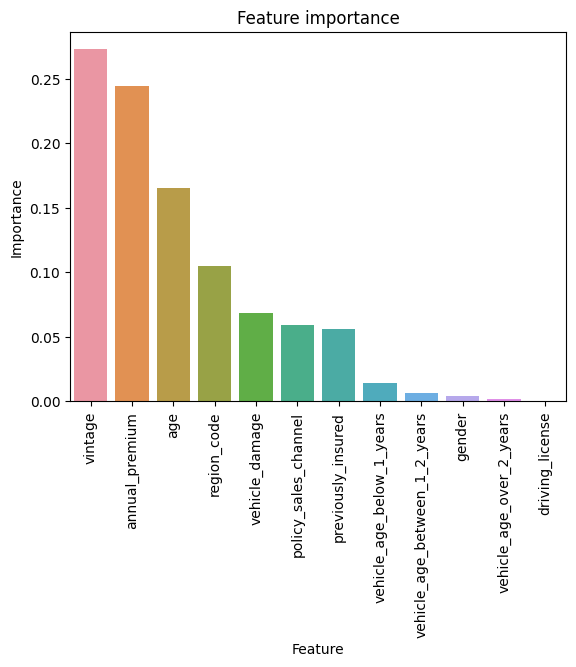

In [42]:
# Printando as colunas e suas respectivas importâncias
importances = forest.feature_importances_
columns = x_train_n.columns

# Criando um DataFrame para facilitar a visualização
importance_df = pd.DataFrame({'Feature': columns, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

print(importance_df)

#plotando grafico de importancia
plt.title('Feature importance')
plt.xticks(rotation=90)
sns.barplot(data=importance_df, x='Feature', y='Importance')

## Machine Learning

In [43]:
cols_selected = ['vintage', 'annual_premium', 'age', 'region_code', 'vehicle_damage',
                 'policy_sales_channel', 'previously_insured']

x_train = data[cols_selected].copy()
x_val = x_validation[cols_selected].copy()

### ATENÇÃO

 1.  O modelo não irá calcular qual cliente será classificado como comprador e não comprador.

 2.  O modelo era fazer um ranking de probabilidade de compra de acordo com as features.


### KNeighborsClassifier

In [44]:
#model definition
knn_model = nh.KNeighborsClassifier(n_neighbors=11)

#model training
knn_model.fit(x_train, y_train)

#model prediction = poder de GENERALIZAÇÃO
yhat_knn = knn_model.predict_proba(x_val)

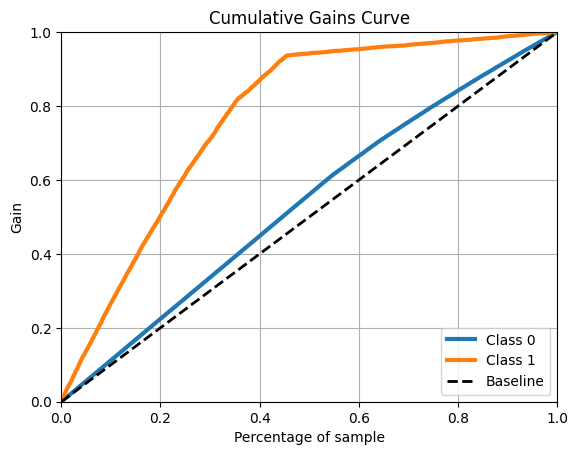

In [45]:
#curva acumulada
skplt.metrics.plot_cumulative_gain(y_validation, yhat_knn);

# Se entrar em contato com 40% dos clientes ordenados na base, encontrará mais de 80% dos interessados

In [46]:
auc = roc_auc_score(y_validation, yhat_knn[:, 1])
print("AUC-ROC:", auc)

AUC-ROC: 0.8082789639153873


### Logistic Regression

In [47]:
#model definition
lr_model = lm.LogisticRegression(random_state=42)

#model training
lr_model.fit(x_train, y_train)

#model prediction
yhat_lr = lr_model.predict_log_proba(x_val)

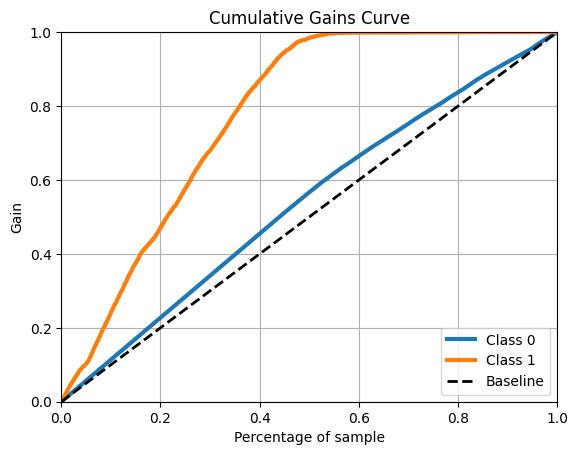

In [48]:
#curva acumulada
skplt.metrics.plot_cumulative_gain(y_validation, yhat_lr);

In [49]:
auc = roc_auc_score(y_validation, yhat_lr[:, 1])
print("AUC-ROC:", auc)

AUC-ROC: 0.8147988987488887


### Extra Trees

In [50]:
#model definition
et = en.ExtraTreesClassifier(n_estimators=1000, n_jobs=-1, random_state=42)

#model fit
et.fit(x_train, y_train)

#model predict
yhat_et = et.predict_proba(x_val)

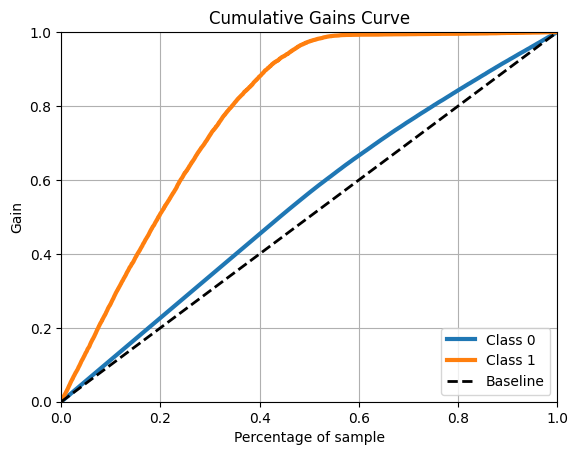

In [51]:
#curva acumulada
skplt.metrics.plot_cumulative_gain(y_validation, yhat_et);

In [52]:
auc = roc_auc_score(y_validation, yhat_et[:, 1])
print("AUC-ROC:", auc)

AUC-ROC: 0.8248438341019214


## Model Performace

In [53]:
#precision_at_k function
def precision_at_k(data, k=2000):
        #reset index
    data = data.reset_index(drop=True)

    #create ranking
    data['ranking'] = data.index + 1
    data['precision_at_k'] = data['response'].cumsum() / data['ranking']

    return data.loc[k, 'precision_at_k']

#recall_at_k function
def recall_at_k(data, k=2000):
        #reset index
    data = data.reset_index(drop=True)

    #create ranking
    data['ranking'] = data.index + 1

    data['recall_at_k'] = data['response'].cumsum() / data['response'].sum()

    return data.loc[k, 'recall_at_k']



In [54]:
#copy data
model_pref = x_validation.copy()
model_pref['response'] = y_validation.copy()

#prepensity score
model_pref['score'] = yhat_knn[:, 1].tolist()

#sorted
model_pref.sort_values(by='score', ascending=False)

#compute precision at k
precision_at_50 = precision_at_k(model_pref, k=50)
print('Precision at k: ', precision_at_50)

#compute recall at k
recall_at_50 = recall_at_k(model_pref, k=50)
print('recall at k: ', recall_at_50)

Precision at k:  0.11764705882352941
recall at k:  0.0006506886454831363


## Deploy model

In [55]:
#pickle.dump(lr_model, open('models/model_linear_regression.pkl', 'wb'))

In [56]:
class HealthInsurance:

    def __init__(self):
        self.home_path = 'D:/comunidade_DS/repos/health_insurance_cross_sell'
        self.annual_premium_scaler =              pickle.load(open( self.home_path + 'src/features/annual_premium_scaler.pkl'))
        self.age_scaler =                         pickle.load(open( self.home_path + 'src/features/age_scaler.pkl'))
        self.vintage_scaler =                     pickle.load(open( self.home_path + 'src/features/vintage_scaler.pkl'))
        self.target_encode_gender_scaler =        pickle.load(open( self.home_path + 'src/features/target_encode_gender_scaler.pkl'))
        self.target_encode_region_code_scaler =   pickle.load(open( self.home_path + 'src/features/target_encode_region_code_scaler.pkl'))
        self.fe_policy_sales_channel_scaler =     pickle.load(open( self.home_path + 'src/features/fe_policy_sales_channel_scaler.pkl'))



    def data_cleaning(df1):
        #rename columns
        cols_new = ['id', 'gende', 'age', 'driving_license', 'region_code', 'previously_insured', 'vehicle_age', 'vehicle_damage',
                    'annual_premium', 'policy_sales_channel', 'vintage', 'response']
        
        #rename
        df1.columns = cols_new

        return df1
    
    def feature_engineering(df2):
        #feature engineering

        #vehicle damage number
        df2['vehicle_damage'] = df2['vehicle_damage'].apply(lambda x: 1 if x == 'Yes' else 0)

        #vehicle age
        df2['vehicle_age'] = df2['vehicle_age'].apply(lambda x: 'over_2_years' if x == '> 2 Years' else 'between_1_2_years' if x == '1-2 Year' else 'below_1_years')

        return df2
    
    def data_preparation(df3):

        #annual_premium
        data['annual_premium'] = self.annual_premium_scaler.transform(df5[['annual_premium']].values)

        #age
        data['age'] = self.age_scaler.transform(data[['age']].values)

        #vintage
        data['vintage'] = self.vintage_scaler.transform(data[['vintage']].values)

        #gender - Frequency Encoding
        data.loc[:, 'gender'] = data['gender'].map(self.target_encode_gender_scaler)

        #region_encoder - Target Encoding
        data.loc[:, 'region_code'] = data['region_code'].map(self.target_encode_region_code_scaler)

        #vehicle_age - One Hot Encoding
        data = pd.get_dummies(data, prefix='vehicle_age', columns=['vehicle_age'])

        #policy_sales_channel - Frequency Encoding
        data.loc[:, 'policy_sales_channel'] = data['policy_sales_channel'].map(self.fe_policy_sales_channel_scaler)

        #feature selection
        cols_selected = ['vintage', 'annual_premium', 'age', 'region_code', 'vehicle_damage',
                 'policy_sales_channel', 'previously_insured']
        
        return df3[cols_selected]
    
    def get_prediction(self, model, original_data, test_data):
        #model prediction
        pred = model.predict_proba(test_data)

        #join prediction into original data
        original_data['prediction'] = pred

        return original_data.to_json(orient='records', date_format='iso')        

## API Handler

In [57]:
import pickle
import pandas as pd
from flask import Flask, request, Response
from healthinsurance import HealthInsurance

#loading model
path = 'D:/comunidade_DS/repos/health_insurance_cross_sell'
model = pickle.load(open(path + '/src/models/model_linear_regression.pkl','rb'))

#inicialization API
app = Flask(__name__)

@app.route('/predict', methods=['POST'])
def health_insurance_predict():
    test_json = request.get_json()

    if test_json: #there is data
        if isinstance(test_json, dict): #unique example
            test_raw = pd.DataFrame(test_json, index=[0])

        else: #mutiple example
            test_raw = pd.DataFrame(test_json, columns=test_json[0].keys())


        #instance class
        pipeline = HealthInsurance()

        #data cleaning
        df1 = pipeline.data_cleaning(test_raw)

        #feature enginnering
        df2 = pipeline.feature_engineering(df1)

        #data preparation
        df3 = pipeline.data_preparation(df2)

        #prediction
        df_response = pipeline.get_prediction(model, test_raw, df3)

        return df_response
    
    else:
        return Response('{}', status=200, mimetype='application/json')

if __name__ == '__main__':
    app.run('0.0.0.0', debug=True)       


 * Serving Flask app '__main__'
 * Debug mode: on


 * Running on all addresses (0.0.0.0)
 * Running on http://127.0.0.1:5000
 * Running on http://192.168.15.6:5000
Press CTRL+C to quit
 * Restarting with stat


SystemExit: 1

c:\Users\Cliente\anaconda3\envs\health_insurance\lib\site-packages\IPython\core\interactiveshell.py:3516: UserWarning:

To exit: use 'exit', 'quit', or Ctrl-D.



## API tester

In [69]:
import json
import requests
import pandas as pd

In [70]:
df_test = pd.read_csv('test.csv')

In [71]:
df_test.head()

,id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage
0,381110,Male,25,1,11.0,1,< 1 Year,No,35786.0,152.0,53
1,381111,Male,40,1,28.0,0,1-2 Year,Yes,33762.0,7.0,111
2,381112,Male,47,1,28.0,0,1-2 Year,Yes,40050.0,124.0,199
3,381113,Male,24,1,27.0,1,< 1 Year,Yes,37356.0,152.0,187
4,381114,Male,27,1,28.0,1,< 1 Year,No,59097.0,152.0,297


In [72]:
"""#loading test dataset
df_test = x_validation
df_test['response'] = y_validation"""

"#loading test dataset\ndf_test = x_validation\ndf_test['response'] = y_validation"

In [73]:
df_test = df_test.sample(10)

In [74]:
#convert dataframe to json
data = json.dumps(df_test.to_dict(orient='records'))

In [75]:
data

'[{"id": 489948, "Gender": "Female", "Age": 41, "Driving_License": 1, "Region_Code": 47.0, "Previously_Insured": 1, "Vehicle_Age": "1-2 Year", "Vehicle_Damage": "No", "Annual_Premium": 2630.0, "Policy_Sales_Channel": 55.0, "Vintage": 259}, {"id": 413742, "Gender": "Male", "Age": 22, "Driving_License": 1, "Region_Code": 10.0, "Previously_Insured": 1, "Vehicle_Age": "< 1 Year", "Vehicle_Damage": "No", "Annual_Premium": 13274.0, "Policy_Sales_Channel": 152.0, "Vintage": 38}, {"id": 402790, "Gender": "Female", "Age": 32, "Driving_License": 1, "Region_Code": 14.0, "Previously_Insured": 1, "Vehicle_Age": "< 1 Year", "Vehicle_Damage": "No", "Annual_Premium": 24697.0, "Policy_Sales_Channel": 152.0, "Vintage": 152}, {"id": 469434, "Gender": "Female", "Age": 24, "Driving_License": 1, "Region_Code": 17.0, "Previously_Insured": 1, "Vehicle_Age": "< 1 Year", "Vehicle_Damage": "No", "Annual_Premium": 34547.0, "Policy_Sales_Channel": 152.0, "Vintage": 267}, {"id": 490506, "Gender": "Male", "Age": 39,

In [77]:
#API Call
url = 'http://192.168.15.6:5000/predict'
header = {'content-type': 'application/json'}
data = data


r = requests.post(url, data=data, headers=header)
print('status code {}'.format(r.status_code))


status code 200


In [83]:
final = pd.DataFrame(r.json())
final.sort_values(ascending=False, by='prediction')

,id,gender,age,driving_license,region_code,previously_insured,vehicle_age,vehicle_damage,annual_premium,policy_sales_channel,vintage,prediction
9,505264,0.103062,0.584615,1,0.105911,0,between_1_2_years,1,-1.622301,156.0,0.401384,0.238304
7,491908,0.103062,0.600000,1,0.062781,0,between_1_2_years,1,0.119744,65.0,0.826990,0.208872
5,467302,0.138262,0.092308,1,0.075966,0,below_1_years,0,-0.399408,160.0,0.854671,0.034346
4,490506,0.138262,0.292308,1,0.186734,1,between_1_2_years,0,0.410588,29.0,0.242215,0.001050
0,489948,0.103062,0.323077,1,0.085341,1,between_1_2_years,0,-1.622301,55.0,0.861592,0.000645
6,466198,0.103062,0.061538,1,0.123673,1,below_1_years,0,-0.124010,152.0,0.401384,0.000614
8,429019,0.103062,0.169231,1,0.121056,1,below_1_years,0,1.177153,152.0,0.851211,0.000599
2,402790,0.103062,0.184615,1,0.088966,1,below_1_years,0,-0.340996,152.0,0.491349,0.000514
3,469434,0.103062,0.061538,1,0.069602,1,below_1_years,0,0.230937,152.0,0.889273,0.000479
1,413742,0.138262,0.030769,1,0.062518,1,below_1_years,0,-1.004264,152.0,0.096886,0.000466
